In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv("VENTAS_TROCIUK3.csv", sep=";", encoding="latin-1")


In [ ]:
df.columns

Index(['FECHA,"COD_ARTICULO","DESCRIPCION","TOTAL_CANTIDAD","PRECIO_UNITARIO"'], dtype='object')

In [ ]:
df = pd.read_csv("VENTAS_TROCIUK3.csv", sep=";", encoding="latin-1")
df


,"FECHA,""COD_ARTICULO"",""DESCRIPCION"",""TOTAL_CANTIDAD"",""PRECIO_UNITARIO"""
0,"17/07/2003,""1550"",""Aves Ponedora 50 Kg."",15,52200"
1,"19/07/2003,""1550"",""Aves Ponedora 50 Kg."",15,52200"
2,"24/07/2003,""1550"",""Aves Ponedora 50 Kg."",30,52200"
3,"30/07/2003,""1550"",""Aves Ponedora 50 Kg."",30,52200"
4,"05/08/2003,""1550"",""Aves Ponedora 50 Kg."",12,51450"
...,...
573468,"12/12/2024,""4827"",""Pez Engorde - 24% (15 - 20 ..."
573469,"12/12/2024,""4828"",""Pez Crecimiento Plus - 32% ..."
573470,"12/12/2024,""68945"",""Lactomix A.P. HIGH PROTEIN..."
573471,"12/12/2024,""69041"",""Lactomix AP HIGH PROTEIN-B..."


In [ ]:
df = pd.read_csv("VENTAS_TROCIUK3.csv", sep=",", encoding="latin-1", quotechar='"', on_bad_lines="skip")
df.to_csv("VENTAS_TROCIUK3_4webapp.csv", index=False)

In [ ]:
# Contar ocurrencias en la columna "DESCRIPCION"
descripcion_counts = df["DESCRIPCION"].value_counts()

# Filtrar los valores con más de 365 registros
filtered_descriptions = descripcion_counts[descripcion_counts > 3650].index.tolist()

len(filtered_descriptions)


40

In [ ]:
# Ahora voy a trabajar solamente con filtered_descriptions, son 40 productos los cuales tiene mas de 3650 registros

In [ ]:
!pip install prophet


In [ ]:
from prophet import Prophet
import pandas as pd
import os

# Create a directory for forecasts
output_dir = "forecasts"
os.makedirs(output_dir, exist_ok=True)

# Iterate over each product
productos = df["DESCRIPCION"].unique()

for producto in productos:
    # Filter the data for the current product
    df_producto = df[df["DESCRIPCION"] == producto]
    df_producto = df_producto[["FECHA", "TOTAL_CANTIDAD"]].rename(columns={"FECHA": "ds", "TOTAL_CANTIDAD": "y"})
    df_producto["ds"] = pd.to_datetime(df_producto["ds"], format="%d/%m/%Y")

    # Check if there are at least 2 valid rows
    if df_producto["y"].notnull().sum() < 2:
        print(f"Producto {producto} omitido: menos de 2 registros válidos.")
        continue

    # Create and fit the Prophet model
    model = Prophet()
    model.fit(df_producto)

    # Create future dates and generate the forecast
    future = model.make_future_dataframe(periods=365)
    forecast = model.predict(future)

    # Save the forecast to a CSV file
    file_name = f"{output_dir}/{producto.replace(' ', '_')}_forecast.csv"
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].to_csv(file_name, index=False)
    print(f"Saved forecast for {producto} to {file_name}")


NameError: name 'df' is not defined

In [ ]:
import shutil

# Comprimir la carpeta forecasts
shutil.make_archive('forecasts', 'zip', 'forecasts')


'/content/forecasts.zip'

In [ ]:
from google.colab import files

# Descargar el archivo comprimido
files.download('forecasts.zip')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

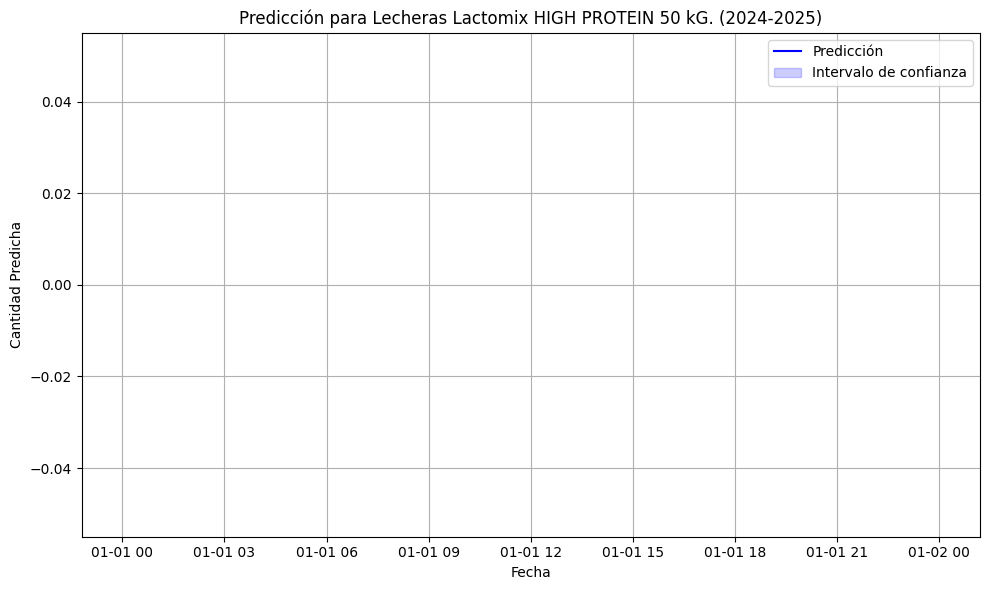

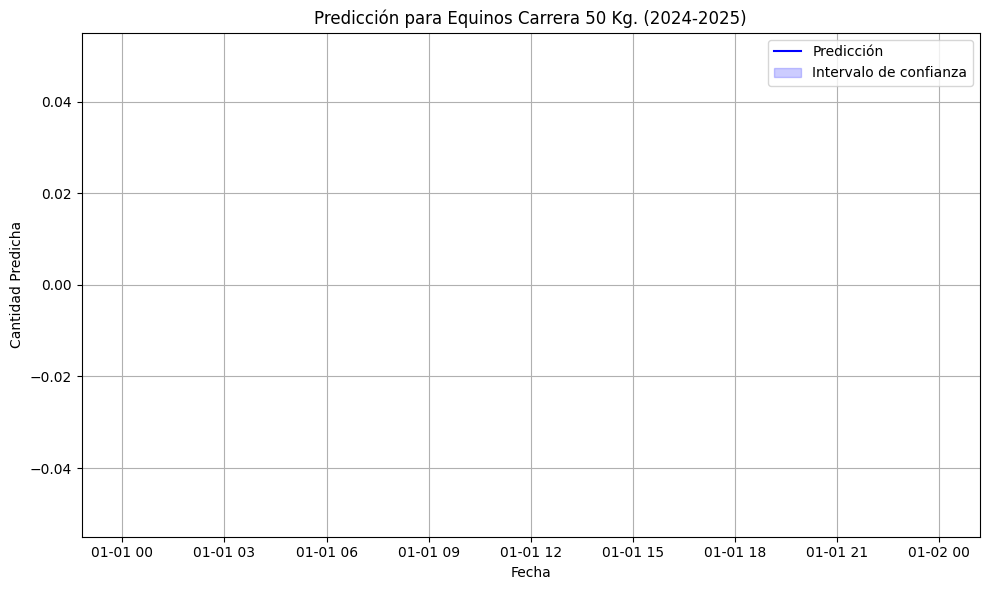

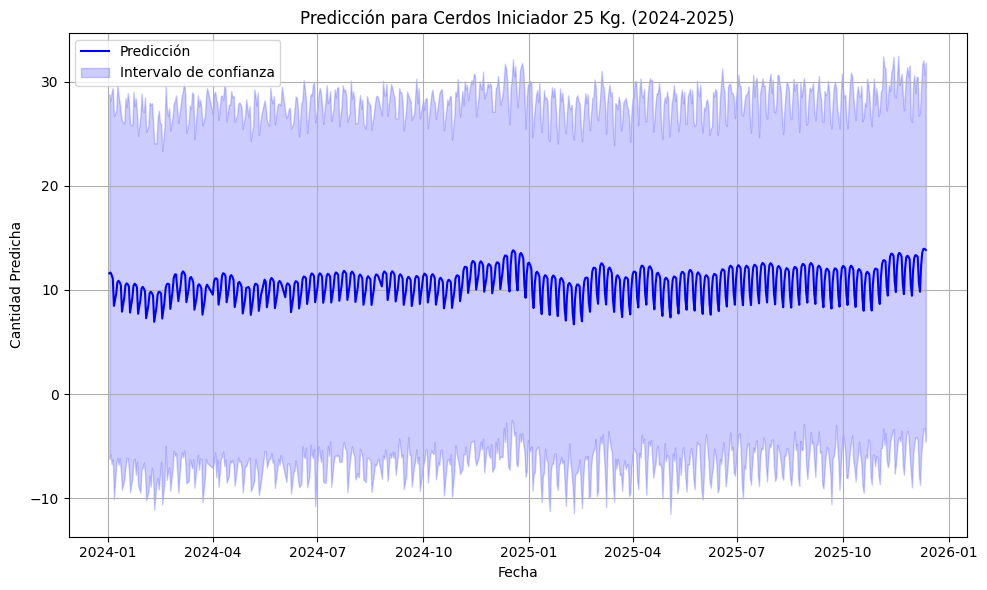

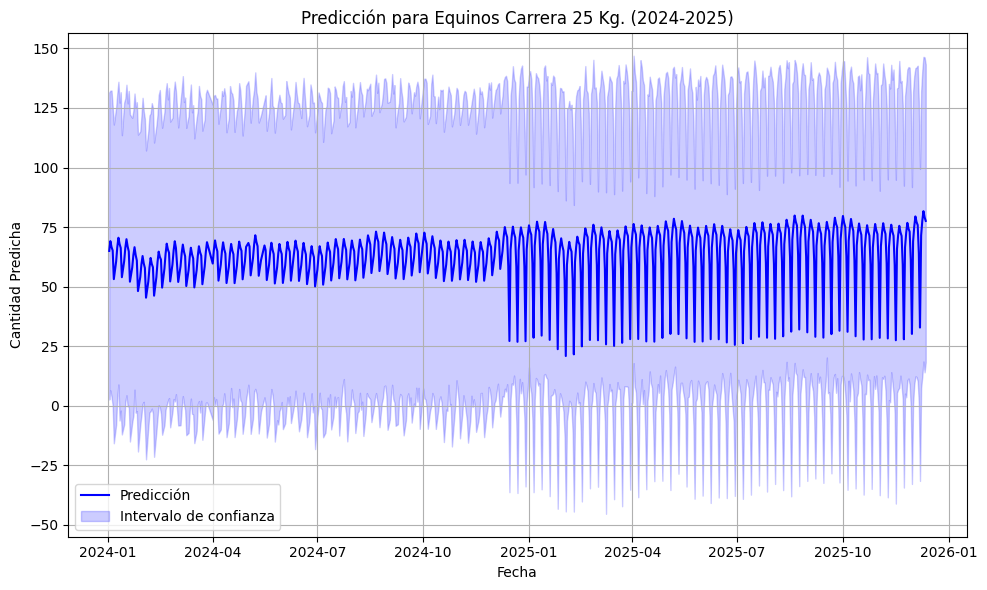

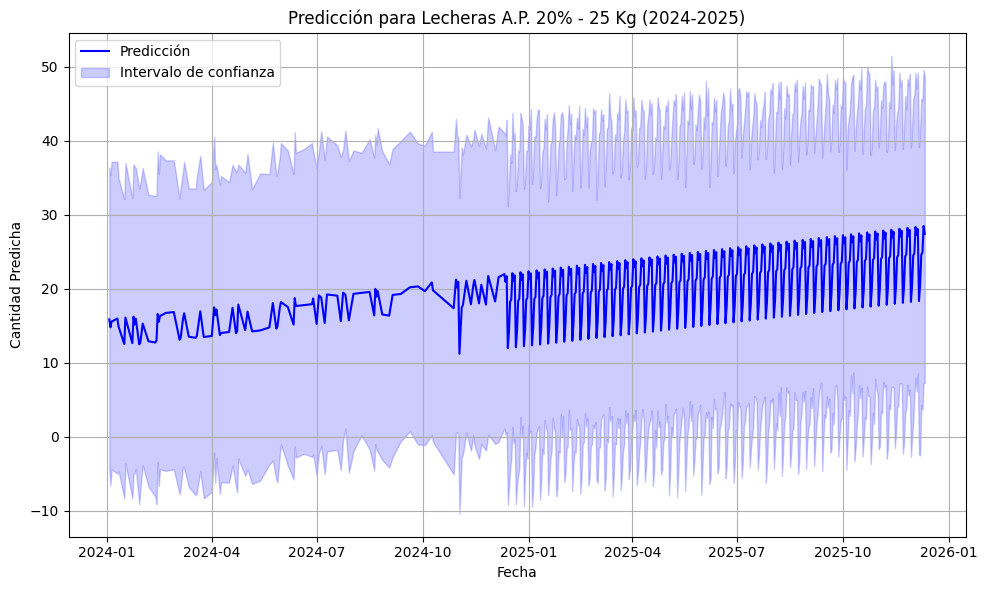

...

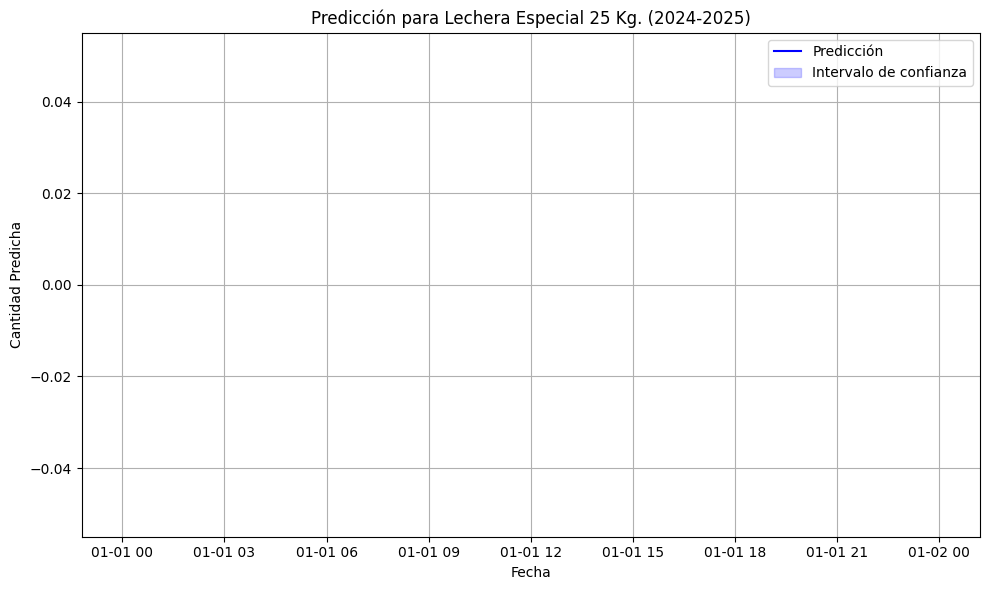

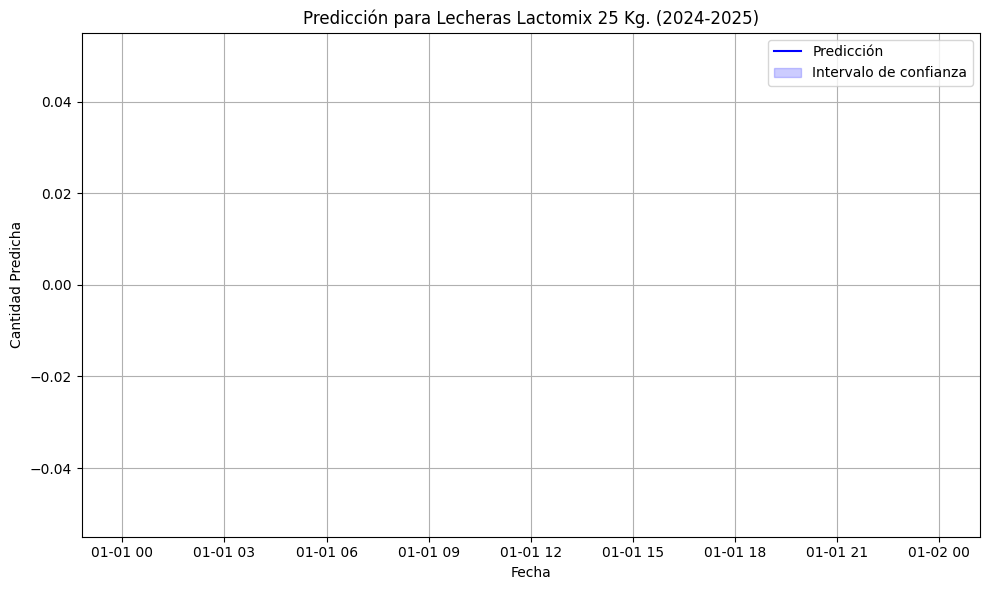

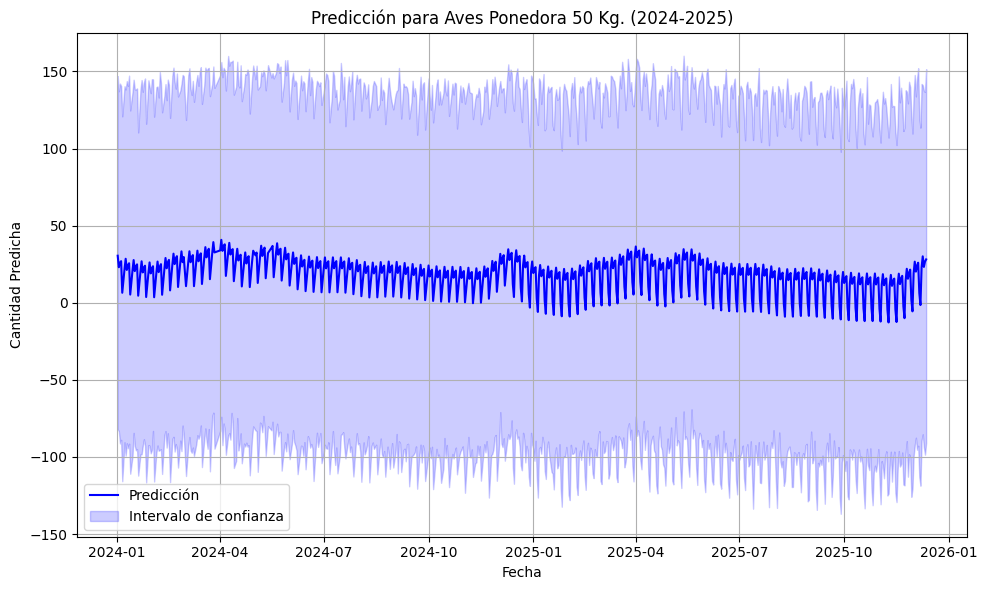

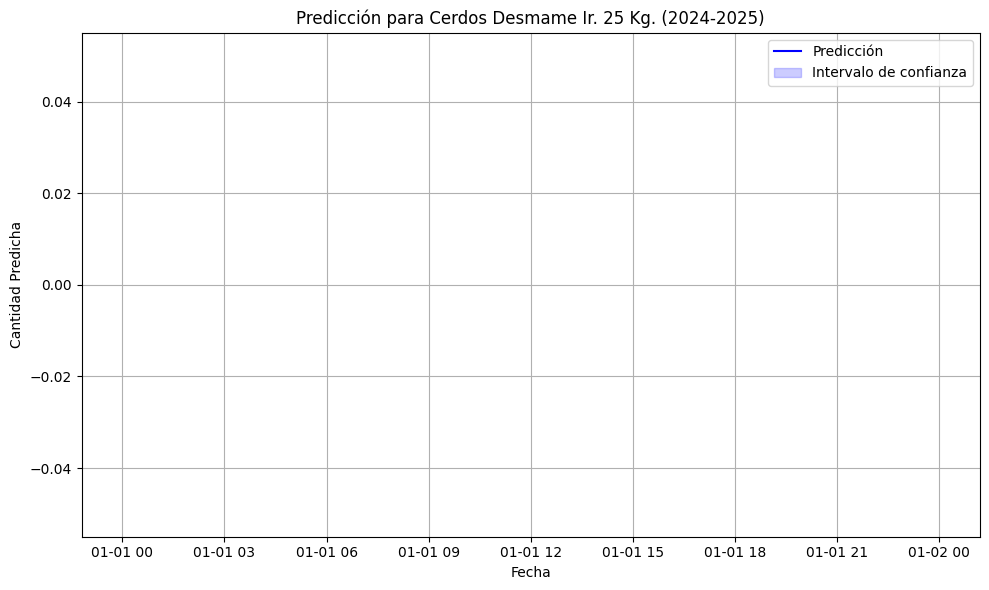

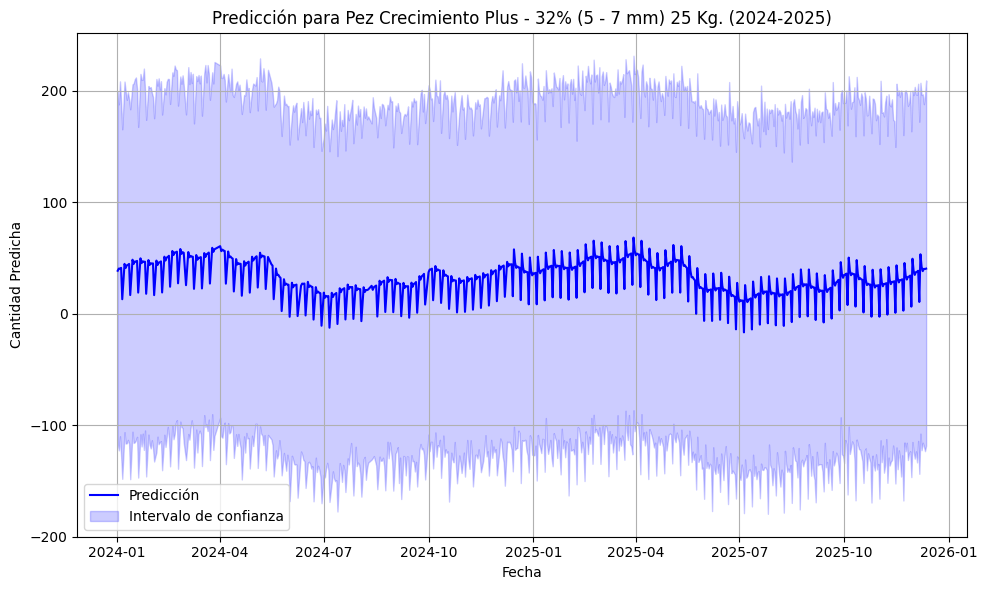

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Carpeta donde están los archivos de forecast
forecast_dir = "forecasts"

# Lista de archivos de forecast
forecast_files = [f for f in os.listdir(forecast_dir) if f.endswith('.csv')]

# Crear gráficos para cada archivo de forecast
for file in forecast_files:
    # Cargar el archivo
    file_path = os.path.join(forecast_dir, file)
    forecast = pd.read_csv(file_path)

    # Convertir la columna 'ds' a datetime
    forecast['ds'] = pd.to_datetime(forecast['ds'])

    # Filtrar los datos para 2024 y 2025
    forecast_2024_2025 = forecast[(forecast['ds'].dt.year >= 2024) & (forecast['ds'].dt.year <= 2025)]

    # Crear el gráfico
    plt.figure(figsize=(10, 6))
    plt.plot(forecast_2024_2025['ds'], forecast_2024_2025['yhat'], label='Predicción', color='blue')
    plt.fill_between(forecast_2024_2025['ds'], forecast_2024_2025['yhat_lower'], forecast_2024_2025['yhat_upper'],
                     color='blue', alpha=0.2, label='Intervalo de confianza')
    plt.title(f"Predicción para {file.replace('_forecast.csv', '').replace('_', ' ')} (2024-2025)")
    plt.xlabel("Fecha")
    plt.ylabel("Cantidad Predicha")
    plt.legend()
    plt.grid()
    plt.tight_layout()

    # Mostrar el gráfico
    plt.show()


In [ ]:
import pandas as pd
import os

# Directorio original de archivos de forecast
forecast_dir = "forecasts"

# Crear una carpeta para guardar los forecasts positivos
positive_forecast_dir = "forecast_positivos"
os.makedirs(positive_forecast_dir, exist_ok=True)

# Lista de archivos de forecast
forecast_files = [f for f in os.listdir(forecast_dir) if f.endswith('.csv')]

# Contador de archivos positivos
positive_file_count = 0

# Resumen de valores eliminados
summary = []

# Procesar cada archivo
for file in forecast_files:
    # Cargar el archivo
    file_path = os.path.join(forecast_dir, file)
    forecast = pd.read_csv(file_path)

    # Convertir la columna 'ds' a datetime
    forecast['ds'] = pd.to_datetime(forecast['ds'])

    # Filtrar datos para 2024 y 2025
    forecast_2024_2025 = forecast[(forecast['ds'].dt.year >= 2024) & (forecast['ds'].dt.year <= 2025)]

    # Número de valores originales
    original_count = len(forecast_2024_2025)

    # Filtrar valores positivos
    forecast_filtered = forecast_2024_2025[forecast_2024_2025['yhat'] >= 0]

    # Número de valores eliminados
    removed_count = original_count - len(forecast_filtered)
    summary.append({
        "Archivo": file,
        "Originales": original_count,
        "Eliminados": removed_count,
        "Positivos": len(forecast_filtered)
    })

    # Guardar los datos filtrados en la nueva carpeta si hay positivos
    if len(forecast_filtered) > 0:
        positive_file_path = os.path.join(positive_forecast_dir, file)
        forecast_filtered.to_csv(positive_file_path, index=False)
        positive_file_count += 1
        print(f"Archivo positivo guardado: {file}")

# Mostrar el resumen
summary_df = pd.DataFrame(summary)
print("\nResumen de valores eliminados por archivo:")
print(summary_df)

# Número total de archivos positivos
print(f"\nTotal de archivos con datos positivos: {positive_file_count}")


Archivo positivo guardado: Cerdos_Iniciador_25_Kg._forecast.csv
Archivo positivo guardado: Equinos_Carrera_25_Kg._forecast.csv
Archivo positivo guardado: Lecheras_A.P._20%_-_25_Kg_forecast.csv
Archivo positivo guardado: Bovino_Ternero_Inicial_25_Kg._forecast.csv
Archivo positivo guardado: Conejos_25_Kg._forecast.csv
Archivo positivo guardado: Equinos_Potro_25_Kg._forecast.csv
Archivo positivo guardado: Bovino_Engorde_High_Energy_50_Kg_forecast.csv
Archivo positivo guardado: Aves_Ponedora_Big_Bag_1250_kg._forecast.csv
Archivo positivo guardado: Lactomix_A.P._HIGH_PROTEIN_50_Kg._forecast.csv
Archivo positivo guardado: Campo_Total_-_50_KG_forecast.csv
Archivo positivo guardado: Lecheras_A.P._20%_-_50_Kg_forecast.csv
Archivo positivo guardado: Cerdos_Terminador_25_Kg._forecast.csv
Archivo positivo guardado: Desmamante_Campo_25_Kg._forecast.csv
Archivo positivo guardado: Aves_Iniciador_25_Kg._forecast.csv
Archivo positivo guardado: Lecheras_A.P._22%_Big_Bag_1.250_Kg._forecast.csv
Archivo po

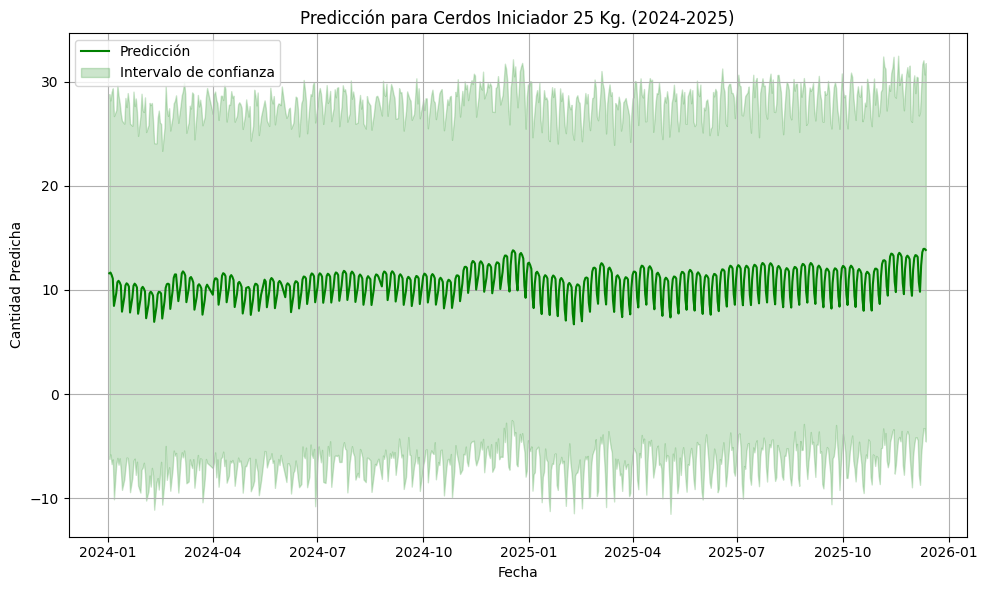

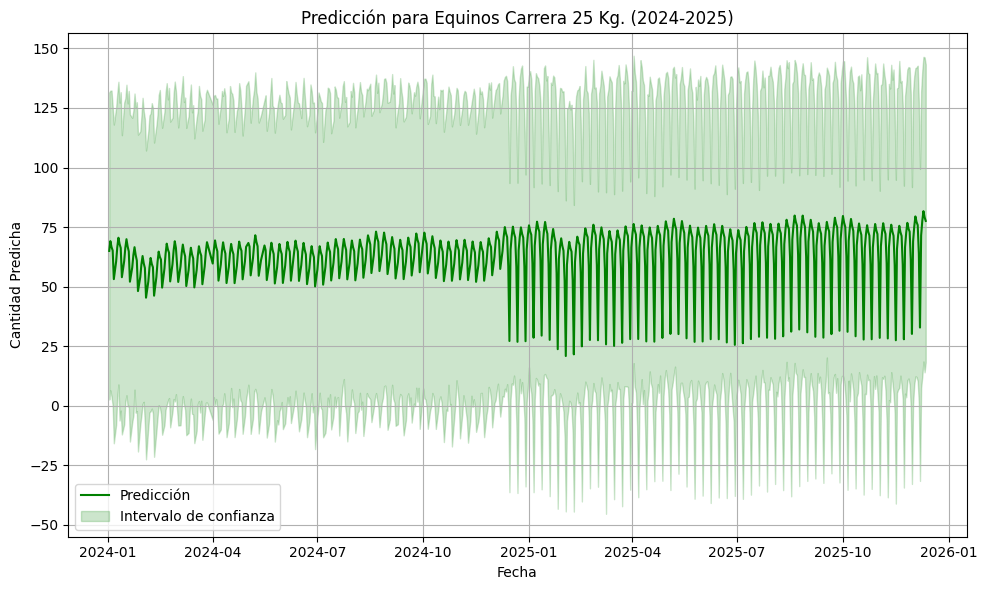

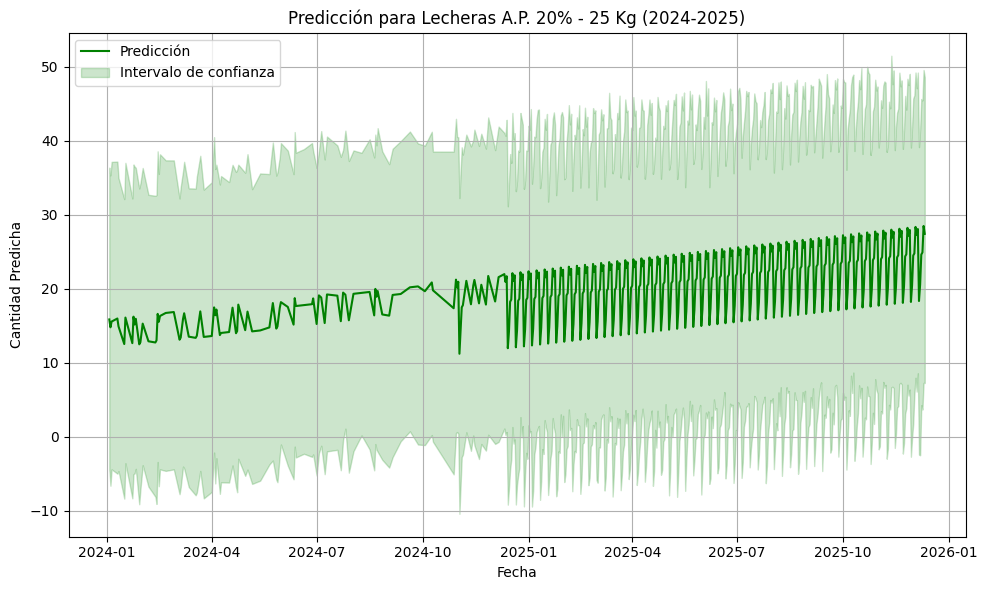

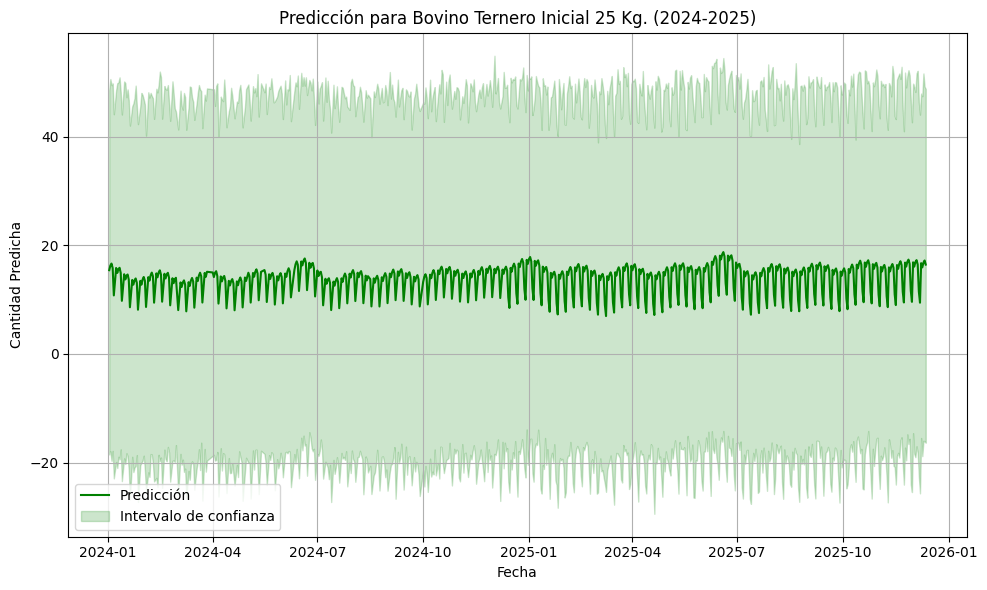

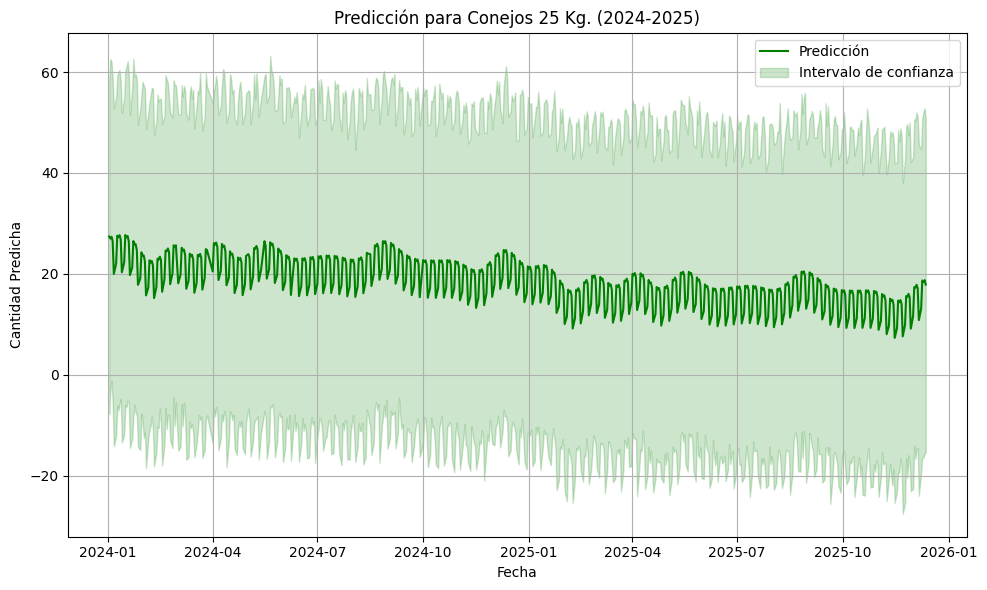

...

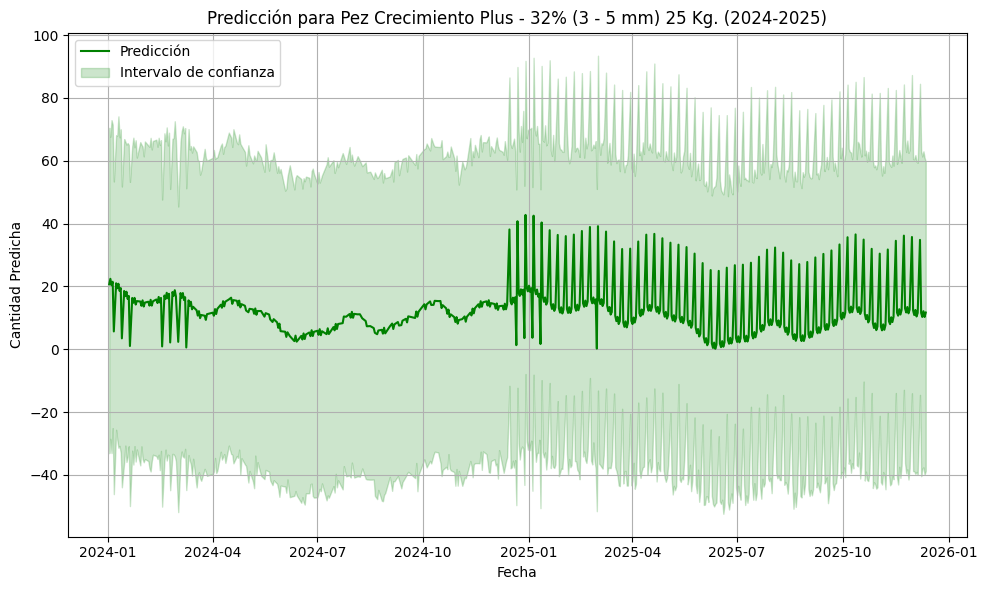

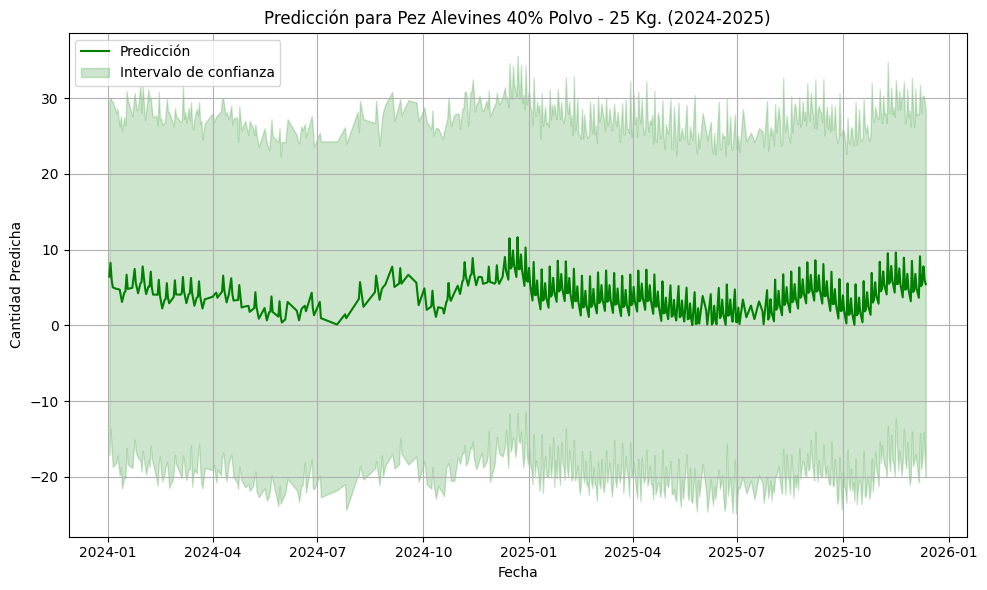

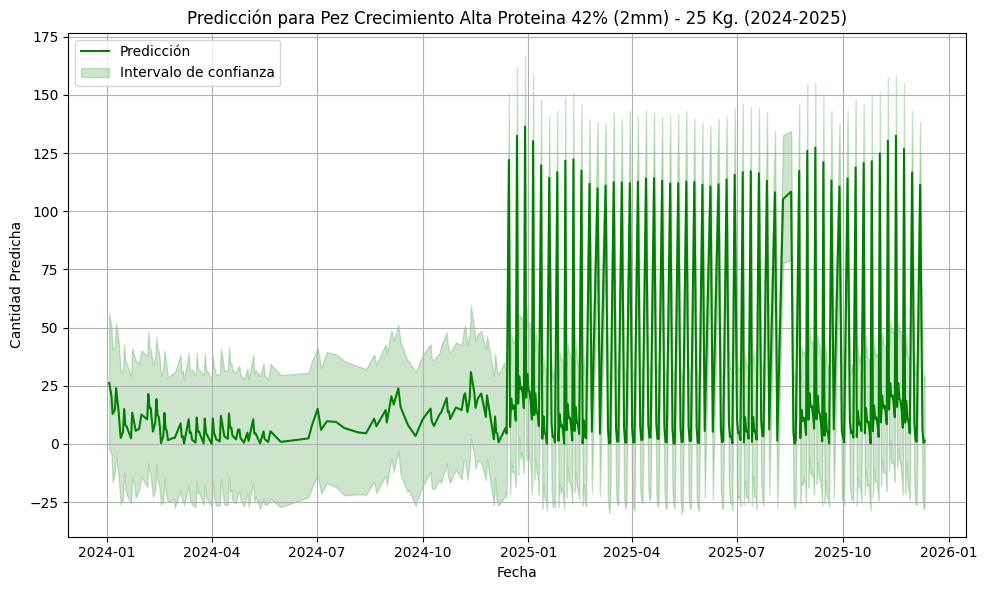

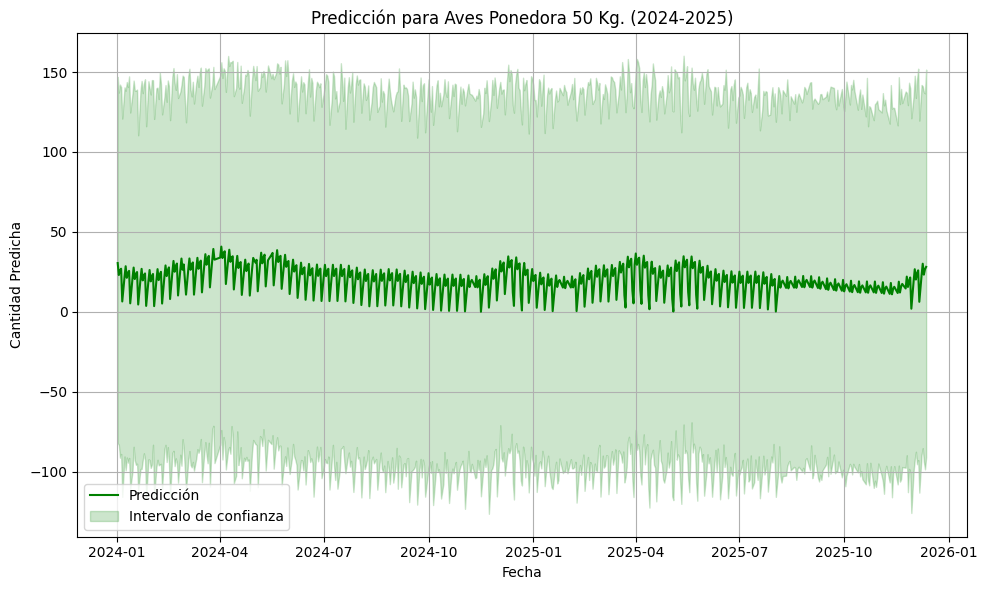

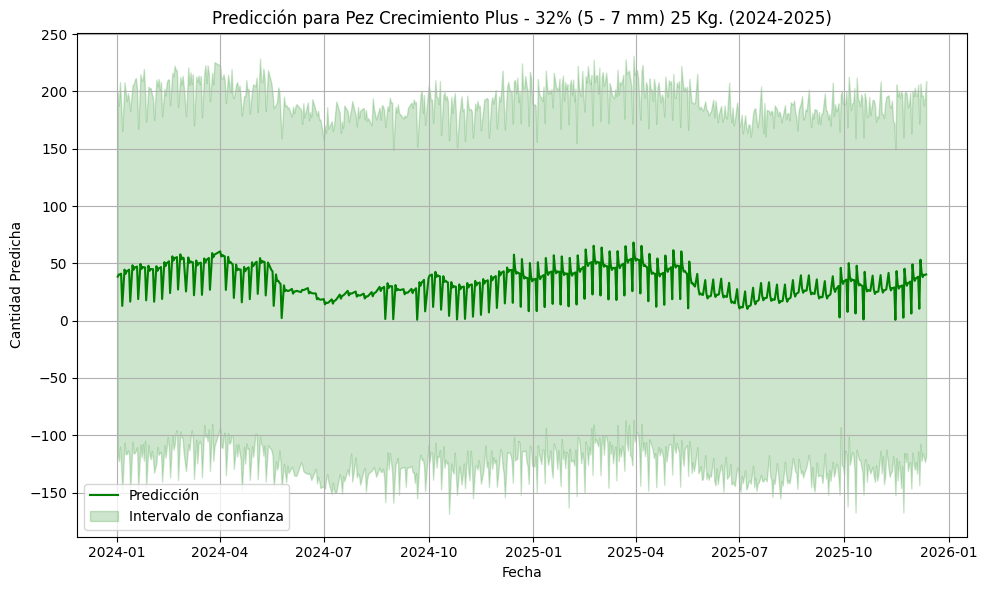

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Carpeta donde están los archivos filtrados con datos positivos
positive_forecast_dir = "forecast_positivos"

# Lista de archivos positivos
positive_forecast_files = [f for f in os.listdir(positive_forecast_dir) if f.endswith('.csv')]

# Crear gráficos para cada archivo de forecast positivo
for file in positive_forecast_files:
    # Cargar el archivo
    file_path = os.path.join(positive_forecast_dir, file)
    forecast = pd.read_csv(file_path)

    # Convertir la columna 'ds' a datetime
    forecast['ds'] = pd.to_datetime(forecast['ds'])

    # Filtrar los datos para 2024 y 2025
    forecast_2024_2025 = forecast[(forecast['ds'].dt.year >= 2024) & (forecast['ds'].dt.year <= 2025)]

    # Crear el gráfico
    plt.figure(figsize=(10, 6))
    plt.plot(forecast_2024_2025['ds'], forecast_2024_2025['yhat'], label='Predicción', color='green')
    plt.fill_between(forecast_2024_2025['ds'], forecast_2024_2025['yhat_lower'], forecast_2024_2025['yhat_upper'],
                     color='green', alpha=0.2, label='Intervalo de confianza')
    plt.title(f"Predicción para {file.replace('_forecast.csv', '').replace('_', ' ')} (2024-2025)")
    plt.xlabel("Fecha")
    plt.ylabel("Cantidad Predicha")
    plt.legend()
    plt.grid()
    plt.tight_layout()

    # Mostrar el gráfico
    plt.show()


In [ ]:
import pandas as pd
import os

# Corrected top 10 forecasts with MAE values
top_10_forecasts = [
    ('Pez Alevines 40% Polvo - 25 Kg.', 5.597368773308119),
    ('Cerdos Terminador 50 Kg.', 6.584974200643059),
    ('Avestruz 25 Kg.', 7.220623255423426),
    ('Cerdos Gestación 25 Kg.', 8.821508695382374),
    ('Cerdos Iniciador 25 Kg.', 19.642188016859066),
    ('Cerdos Lactación 25 Kg.', 30.021179796728386),
    ('Bovino Ternero Inicial 25 Kg.', 33.705941662415654),
    ('Aves Ponedora 50 Kg.', 35.003559436725325),
    ('Ovino Plus 18% - 25 Kg.', 44.22282347923771),
    ('Codorniz 25 Kg.', 45.359720412151624),
]

# Directory containing positive forecast files
positive_forecast_dir = "forecast_positivos"

# Initialize an empty DataFrame for consolidated data
consolidated_data = pd.DataFrame()

# Process each forecast in the top 10 list
for product_name, mae in top_10_forecasts:
    # Format the product name to match the file name in the directory
    file_name = product_name.replace(' ', '_').replace('%', '').replace('(', '').replace(')', '').replace('.', '') + '._forecast.csv'
    file_path = os.path.join(positive_forecast_dir, file_name)

    if os.path.exists(file_path):
        # Load the forecast file
        forecast = pd.read_csv(file_path)

        # Add the PRODUCT column
        forecast['PRODUCT'] = product_name

        # Append to the consolidated DataFrame
        consolidated_data = pd.concat([consolidated_data, forecast], ignore_index=True)
    else:
        print(f"File not found: {file_name}")

# Save the consolidated data to a CSV file
output_file = "top_10_forecasts_consolidated.csv"
consolidated_data.to_csv(output_file, index=False)
print(f"Consolidated data saved to {output_file}")


File not found: Pez_Alevines_40_Polvo_-_25_Kg._forecast.csv
File not found: Ovino_Plus_18_-_25_Kg._forecast.csv
Consolidated data saved to top_10_forecasts_consolidated.csv


In [ ]:
consolidated_data

,ds,yhat,yhat_lower,yhat_upper,PRODUCT
0,2024-01-03,11.350679,-62.583924,82.644804,Cerdos Terminador 50 Kg.
1,2024-01-08,4.253253,-73.239609,79.787174,Cerdos Terminador 50 Kg.
2,2024-01-12,7.412985,-68.498057,80.497704,Cerdos Terminador 50 Kg.
3,2024-01-19,6.236511,-72.625952,87.063915,Cerdos Terminador 50 Kg.
4,2024-01-25,3.736194,-72.383250,77.460747,Cerdos Terminador 50 Kg.
...,...,...,...,...,...
4873,2025-12-08,26.037291,-2.783237,54.327240,Codorniz 25 Kg.
4874,2025-12-09,31.447545,3.224301,62.753193,Codorniz 25 Kg.
4875,2025-12-10,30.483139,1.663301,59.667966,Codorniz 25 Kg.
4876,2025-12-11,30.809091,-1.408101,59.042060,Codorniz 25 Kg.


In [ ]:
import pandas as pd

# Asegúrate de que FECHA sea datetime
df["ds"] = pd.to_datetime(df["ds"], format="%d/%m/%Y", errors="coerce")

# Renombra para que coincida con los nombres de consolidated_data
# ds = fecha
# PRODUCT = descripción
df.rename(
    columns={
        "FECHA": "ds",
        "DESCRIPCION": "PRODUCT"
    },
    inplace=True
)


In [ ]:
consolidated_data.columns
# ['ds', 'yhat', 'yhat_lower', 'yhat_upper', 'PRODUCT']


Index(['ds', 'yhat', 'yhat_lower', 'yhat_upper', 'PRODUCT'], dtype='object')

In [ ]:
consolidated_data["ds"] = pd.to_datetime(consolidated_data["ds"], errors="coerce")


In [ ]:
# Elimina puntos finales, espacios sobrantes...
df["PRODUCT"] = df["PRODUCT"].str.strip().str.rstrip(".")
consolidated_data["PRODUCT"] = consolidated_data["PRODUCT"].str.strip().str.rstrip(".")


In [ ]:
import pandas as pd

# Asegúrate de tener ds como datetime en ambos
df["ds"] = pd.to_datetime(df["ds"], errors="coerce")
consolidated_data["ds"] = pd.to_datetime(consolidated_data["ds"], errors="coerce")

# Supongamos que en df ya renombraste las columnas:
# FECHA -> ds
# DESCRIPCION -> PRODUCT
# PRECIO_UNITARIO -> PRECIO_UNITARIO (o "PRECIO", como gustes)
# y que eliminaste o normalizaste cualquier caracter que impida el matcheo

# 1. Creamos una lista para ir almacenando resultados parciales
merge_list = []

# 2. Iteramos por cada PRODUCT en consolidated_data
for prod, group_consol in consolidated_data.groupby("PRODUCT"):
    # Extrae sólo las filas para ese prod en df
    df_prod = df[df["PRODUCT"] == prod].copy()
    # Ordena por ds ASC
    df_prod.sort_values("ds", inplace=True)
    group_consol.sort_values("ds", inplace=True)

    # Si df_prod está vacío o casi vacío, no habrá precios que mapear
    if df_prod.empty:
        # Simplemente anexa group_consol con PRECIO_UNITARIO=NaN
        group_consol["PRECIO_UNITARIO"] = None
        merge_list.append(group_consol)
        continue

    # 3. merge_asof dentro de ese grupo
    #    - direction="backward": usa el precio más reciente <= ds
    merged = pd.merge_asof(
        left=group_consol,                         # forecast del producto
        right=df_prod[["ds", "PRECIO_UNITARIO"]],  # histórico para ese producto
        on="ds",                                   # la columna de fechas
        direction="backward"
    )

    # 4. Guardamos
    merge_list.append(merged)

# 5. Unimos todos los grupos en un solo DataFrame final
merged_data = pd.concat(merge_list, ignore_index=True)

merged_data["PRODUCT"].unique().shape


(8,)

In [ ]:
merged_data.to_csv("merged_data.csv", index=False)